# Self-training RNN

In [11]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

from gensim.models import word2vec
# from tqdm import tqdm
# from tqdm.notebook import tqdm

import torch
from torch import nn 
from torch.utils.data import Dataset,DataLoader
import torch.optim as optim
import torch.nn.functional as F
# 变长序列的处理
from torch.nn.utils.rnn import pad_sequence,pack_padded_sequence,pad_packed_sequence

from sklearn.model_selection import train_test_split

import jieba #分词


path = '../input/njunnfin1'

### Dataset

In [12]:
def load_data(data, label=True):
    if label:
        return list(data['comment']), [y-1 for y in data['value']]
    return list(data['comment'])

def tokenizer(x):
    text_list = [list(jieba.cut(comment)) for comment in x]
    return text_list

In [13]:
class CommentDataset(Dataset):
    """
    Expected data shape like:(data_num, data_len)
    Data can be a list of numpy array or a list of lists
    input data shape : (data_num, seq_len, feature_dim)
    
    __len__ will return the number of data
    """
    def __init__(self, X, y):
        self.data = X
        self.label = y
        
    def __getitem__(self, idx):
        if self.label is None: 
            return self.data[idx]
        return self.data[idx], self.label[idx]
    def __len__(self):
        return len(self.data)

### Data Preprocess

In [14]:
class Preprocess():
    def __init__(self, sentences, sen_len, w2v_path="./w2v.model"):
        self.w2v_path = w2v_path
        self.sentences = sentences
        self.sen_len = sen_len
        self.idx2word = []
        self.word2idx = {}
        self.embedding_matrix = []
    def get_w2v_model(self):
        self.embedding = word2vec.Word2Vec.load(self.w2v_path)
        self.embedding_dim = self.embedding.vector_size
    def add_embedding(self, word):
        vector = torch.empty(1, self.embedding_dim)
        torch.nn.init.uniform_(vector)
        self.word2idx[word] = len(self.word2idx)
        self.idx2word.append(word)
        self.embedding_matrix = torch.cat([self.embedding_matrix, vector], 0)
    def make_embedding(self, load=True):
        print("Get embedding ...")
        if load:
            print("loading word to vec model ...")
            self.get_w2v_model()
        else:
            raise NotImplementedError
        for i, word in enumerate(self.embedding.wv.vocab):
            self.word2idx[word] = len(self.word2idx)
            self.idx2word.append(word)
            self.embedding_matrix.append(self.embedding[word])
        self.embedding_matrix = torch.tensor(self.embedding_matrix)
        self.add_embedding("<PAD>")
        self.add_embedding("<UNK>")
        print("total words: {}".format(len(self.embedding_matrix)))
        return self.embedding_matrix
    def pad_sequence(self, sentence):
        if len(sentence) > self.sen_len:
            sentence = sentence[:self.sen_len]
        else:
            pad_len = self.sen_len - len(sentence)
            for _ in range(pad_len):
                sentence.append(self.word2idx["<PAD>"])
        assert len(sentence) == self.sen_len
        return sentence
    def sentence_word2idx(self):
        sentence_list = []
        for i, sen in enumerate(self.sentences):
            print('sentence count #{}'.format(i+1), end='\r')
            sentence_idx = []
            for word in sen:
                if (word in self.word2idx.keys()):
                    sentence_idx.append(self.word2idx[word])
                else:
                    sentence_idx.append(self.word2idx["<UNK>"])
            sentence_idx = self.pad_sequence(sentence_idx)
            sentence_list.append(sentence_idx)
        return torch.LongTensor(sentence_list)
    def labels_to_tensor(self, y):
        y = [int(label) for label in y]
        return torch.LongTensor(y)

In [15]:
def evaluation(outputs, labels):
    outputs[outputs>=0.5] = 1 
    outputs[outputs<0.5] = 0 
    correct = torch.sum(torch.eq(outputs, labels)).item()
    return correct

### Model

In [16]:
class LSTM_Net(nn.Module):
    def __init__(self, embedding, embedding_dim, hidden_dim, num_layers, dropout=0.3, fix_embedding=True):
        super(LSTM_Net, self).__init__()
        self.embedding = torch.nn.Embedding(embedding.size(0),embedding.size(1))
        self.embedding.weight = torch.nn.Parameter(embedding)
        self.embedding.weight.requires_grad = False if fix_embedding else True
        self.embedding_dim = embedding.size(1)
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers
        self.dropout = dropout
        self.lstm = nn.LSTM(embedding_dim, hidden_dim, num_layers=num_layers, batch_first=True)
        self.classifier = nn.Sequential( nn.Dropout(dropout),
                                         nn.Linear(hidden_dim, 64),
                                         nn.Dropout(dropout),
                                         nn.Linear(64,1),
                                         nn.Sigmoid() )
        
    def forward(self, inputs):
        inputs = self.embedding(inputs)
        x, _ = self.lstm(inputs, None)
        x = x[:, -1, :] 
        x = self.classifier(x)
        return x

### Train

In [17]:
def judge_x_nolabel(train_unlabeled_x_loader, model, device, batch_size, threshold=0.8):

    model.eval()
    ret_inputs = []
    ret_output = []
    with torch.no_grad():
        for i, inputs in enumerate(train_unlabeled_x_loader):
            inputs = inputs.to(device, dtype=torch.long)
            outputs = model(inputs)
            outputs = outputs.squeeze()
            
            temp_inputs = [inputs[i].tolist() for i in range(len(outputs)) if (outputs[i] > 1-threshold or outputs[i] < threshold)]
            ret_inputs += temp_inputs
            temp_inputs = torch.LongTensor(temp_inputs)

            outputs = model(temp_inputs.to(device, dtype=torch.long))

            outputs = outputs.squeeze()
            outputs[outputs>=0.5] = 1 
            outputs[outputs<0.5] = 0 
            ret_output += outputs.int().tolist()
    print(len(ret_inputs))
    ret_inputs = torch.LongTensor(ret_inputs)
    ret_output = torch.LongTensor([int(label) for label in ret_output])
    return ret_inputs, ret_output


def self_training(batch_size, n_epoch, optimizer, model_dir, X_train, y_train, train_unlabeled_x_loader, valid_loader, model, device, threshold=0.2):
    train_loss = []
    valid_loss = []
    train_accs = []
    valid_accs = []

    total = sum(p.numel() for p in model.parameters())
    trainable = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print('\nstart training, parameter total:{}, trainable:{}\n'.format(total, trainable))
    model.train() 
    criterion = nn.BCELoss() 

    total_loss, total_acc, best_acc = 0, 0, 0

    for epoch in range(n_epoch):
        total_loss, total_acc = 0, 0
        if epoch == 0:
            train_dataset = CommentDataset(X=X_train, y=y_train)
        else:
            model.eval() 
            with torch.no_grad():
                train_unlabeled_goodx, train_unlabeled_goody = judge_x_nolabel(train_unlabeled_x_loader, model, device, batch_size, threshold)
                train_unlabeled_goody = torch.LongTensor([int(label) for label in train_unlabeled_goody])

                X =  torch.cat((X_train, train_unlabeled_goodx), 0)
                y =  torch.cat((y_train, train_unlabeled_goody), 0)
                train_dataset = CommentDataset(X=X, y=y)
            
        train_loader = torch.utils.data.DataLoader(dataset = train_dataset,
                                                    batch_size = batch_size,
                                                    shuffle = True,
                                                    num_workers = 8)

        t_batch = len(train_loader) 
        v_batch = len(valid_loader) 
        
        model.train()
        for i, (inputs, labels) in enumerate(train_loader):
            inputs = inputs.to(device, dtype=torch.long) 
            labels = labels.to(device, dtype=torch.float) 
            optimizer.zero_grad() 
            outputs = model(inputs) 
            outputs = outputs.squeeze() 
            loss = criterion(outputs, labels) 
            loss.backward()
            optimizer.step() 
            
            correct = evaluation(outputs, labels) 
            total_acc += (correct / batch_size)
            total_loss += loss.item()
        print('\n[ Epoch{}: ] \nTrain | Loss:{:.5f} Acc: {:.3f}'.format(epoch+1, total_loss/t_batch, total_acc/t_batch*100))
        train_loss.append(total_loss/t_batch)
        train_accs.append(total_acc/t_batch)

        model.eval()
        with torch.no_grad():
            total_loss, total_acc = 0, 0
            for i, (inputs, labels) in enumerate(valid_loader):
                inputs = inputs.to(device, dtype=torch.long) 
                labels = labels.to(device, dtype=torch.float) 
                outputs = model(inputs) 
                outputs = outputs.squeeze() 
                loss = criterion(outputs, labels) 
                correct = evaluation(outputs, labels) 
                total_acc += (correct / batch_size)
                total_loss += loss.item()

            print("Valid | Loss:{:.5f} Acc: {:.3f} ".format(total_loss/v_batch, total_acc/v_batch*100))
            valid_loss.append(total_loss/v_batch)
            valid_accs.append(total_acc/v_batch)

            if total_acc > best_acc:
                best_acc = total_acc
                #torch.save(model, "{}/val_acc_{:.3f}.model".format(model_dir,total_acc/v_batch*100))
                torch.save(model, "{}".format(model_dir))
                print('saving model with acc {:.3f}'.format(total_acc/v_batch*100))
        print('-----------------------------------------------')
        model.train() 
    return train_loss, train_accs, valid_loss, valid_accs

### Main

In [18]:
sen_len = 20
fix_embedding = True 
batch_size = 128
epoch = 10
device = torch.device("cuda")
mdpt = './'
model_dir = os.path.join(mdpt, 'self_training.param')  

In [19]:
train_data = pd.read_csv(os.path.join(path,'train.csv'),index_col=0)
train_unlabeled_data = pd.read_csv(os.path.join(path,'train_unlabeled.csv'),index_col=0)
test_data = pd.read_csv(os.path.join(path, 'test.csv'),index_col=0)

train_x, train_y = load_data(train_data)
train_unlabeled_x = load_data(train_unlabeled_data, False)
test_x = load_data(test_data, False)

train_x = tokenizer(train_x)
train_unlabeled_x =tokenizer(train_unlabeled_x)
test_x = tokenizer(test_x)


In [ ]:
x = train_x + train_unlabeled_x + test_x
word2vec_model = word2vec.Word2Vec(x, size=250, window=5, min_count=5, workers=12, iter=10, sg=1)
w2v_path = os.path.join(mdpt, 'w2v_all.model')
word2vec_model.save(w2v_path)

In [20]:
w2v_path = os.path.join(mdpt, 'w2v_all.model')
preprocess = Preprocess(train_x, sen_len, w2v_path=w2v_path)
embedding = preprocess.make_embedding(load=True)
train_x = preprocess.sentence_word2idx()
y = preprocess.labels_to_tensor(train_y)

X_train, X_val, y_train, y_val = train_x[:180000], train_x[180000:], y[:180000], y[180000:]

val_dataset = CommentDataset(X=X_val, y=y_val)


val_loader = torch.utils.data.DataLoader(dataset = val_dataset,
                                            batch_size = batch_size,
                                            shuffle = False,
                                            num_workers = 8)

preprocess = Preprocess(train_unlabeled_x, sen_len, w2v_path=w2v_path)
embedding = preprocess.make_embedding(load=True)
X_train_unlabeled = preprocess.sentence_word2idx()

train_unlabeled_dataset = CommentDataset(X=X_train_unlabeled, y=None)

train_unlabeld_x_loader = torch.utils.data.DataLoader(dataset = train_unlabeled_dataset,
                                        batch_size = batch_size,
                                        shuffle = False,
                                        num_workers = 8)

Get embedding ...
loading word to vec model ...


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:35: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


total words: 102678


sentence count #4037

sentence count #8036

sentence count #12035

sentence count #16034

sentence count #20033

sentence count #23532

sentence count #31030

sentence count #32804

sentence count #34029

sentence count #35801

sentence count #37528

sentence count #39217

sentence count #45026

sentence count #49025

sentence count #52524

sentence count #56523

sentence count #60022

sentence count #61968

sentence count #71519

sentence count #83016

sentence count #87015

sentence count #91014

sentence count #95013

sentence count #99012

sentence count #100908

sentence count #102912

sentence count #106901

sentence count #110509

sentence count #114300

sentence count #117507

sentence count #119317

sentence count #121506

sentence count #125005

sentence count #129004

sentence count #142501

sentence count #152691

sentence count #158798

sentence count #169269

sentence count #181491

sentence count #185490

sentence count #189068

sentence count #196487

Get embedding ...
loading word to vec model ...


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:35: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


total words: 102678


sentence count #5980

sentence count #9979

sentence count #13978

sentence count #17977

sentence count #21976

sentence count #25975

sentence count #31685

sentence count #33473

sentence count #36302

sentence count #39845

sentence count #41639

sentence count #43395

sentence count #46969

sentence count #50968

sentence count #58466

sentence count #62465

sentence count #80059

sentence count #80960

sentence count #84896

sentence count #88277

sentence count #91957

sentence count #99455

sentence count #103454

sentence count #110952

sentence count #112877

sentence count #114451

sentence count #116092

sentence count #117816

sentence count #121079

sentence count #124948

sentence count #135445

sentence count #137336

sentence count #138899

sentence count #146193

sentence count #149941

sentence count #156439

sentence count #159938

sentence count #163437

sentence count #167436

sentence count #169432

sentence count #170935

sentence count #174345

sentence count #177933

sentence count #184431

sentence count #187930

sentence count #191429

sentence count #194928

sentence count #198427

sentence count #201712

sentence count #204915

sentence count #208424

sentence count #215922

sentence count #219921

sentence count #223920

sentence count #227919

sentence count #235417

sentence count #238801

sentence count #242291

sentence count #245914

sentence count #249913

sentence count #253912

sentence count #257911

sentence count #261910

sentence count #266409

sentence count #270908

sentence count #274907

sentence count #277906

sentence count #281905

sentence count #285904

sentence count #289903

sentence count #298901

sentence count #302900

sentence count #306899

sentence count #311398

sentence count #315397

sentence count #319396

sentence count #323395

sentence count #327265

sentence count #330893

sentence count #334892

sentence count #338891

sentence count #343390

sentence count #347889

sentence count #351888

sentence count #356387

sentence count #360386

sentence count #364385

sentence count #368735

sentence count #372883

sentence count #377382

sentence count #378976

sentence count #380881

sentence count #384880

sentence count #387223

sentence count #388879

sentence count #392878

sentence count #397377

sentence count #401376

sentence count #405875

sentence count #409874

sentence count #414373

sentence count #418372

sentence count #422371

sentence count #426370

sentence count #430369

sentence count #434368

sentence count #438367

sentence count #440866

sentence count #444865

sentence count #449364

sentence count #453863

sentence count #457862

sentence count #461361

sentence count #465360

sentence count #469359

sentence count #473358

sentence count #477857

sentence count #482356

sentence count #486355

sentence count #490354

sentence count #494353

sentence count #498352

sentence count #500170

sentence count #502097

sentence count #503588

sentence count #505350

sentence count #509349

sentence count #513348

sentence count #517347

sentence count #521346

sentence count #525345

sentence count #529344

sentence count #533843

sentence count #537842

sentence count #541841

sentence count #545840

sentence count #549839

sentence count #553664

sentence count #555631

sentence count #557337

sentence count #563497

sentence count #565835

sentence count #569834

sentence count #573833

sentence count #577832

sentence count #581831

sentence count #585830

sentence count #589329

sentence count #593328

sentence count #597327

sentence count #601326

sentence count #605325

sentence count #609324

sentence count #613323

sentence count #617322

sentence count #621321

sentence count #625320

sentence count #633175

sentence count #636817

sentence count #640816

sentence count #644815

sentence count #648814

sentence count #653313

sentence count #657312

sentence count #661311

sentence count #665310

sentence count #669309

sentence count #673308

sentence count #677307

sentence count #681306

sentence count #685305

sentence count #689304

sentence count #693303

sentence count #695322

sentence count #697302

sentence count #700801

sentence count #704800

sentence count #708799

sentence count #712798

sentence count #716797

sentence count #720796

sentence count #722518

sentence count #724295

sentence count #727794

sentence count #729658

sentence count #735292

sentence count #739291

sentence count #743290

sentence count #746789

sentence count #748539

sentence count #749874

sentence count #752950

sentence count #754670

sentence count #756286

sentence count #758261

sentence count #759785

sentence count #763284

sentence count #770282

sentence count #776943

sentence count #780779

sentence count #784683

sentence count #788076

sentence count #791776

sentence count #795775

sentence count #798774

sentence count #799894

sentence count #800273

sentence count #800977

sentence count #802772

sentence count #804557

sentence count #806271

sentence count #810270

sentence count #812190

sentence count #813769

sentence count #817768

sentence count #821451

sentence count #825266

sentence count #828765

sentence count #832264

sentence count #836263

sentence count #840262

sentence count #844413

sentence count #846418

sentence count #848260

sentence count #852259

sentence count #856258

sentence count #860257

sentence count #864256

sentence count #868255

sentence count #871754

sentence count #875220

sentence count #878752

sentence count #882251

sentence count #886250

sentence count #889749

sentence count #893276

sentence count #897247

sentence count #901376

sentence count #905245

sentence count #909244

sentence count #917177

sentence count #919179

sentence count #925740

sentence count #929739

sentence count #933738

sentence count #937737

sentence count #942236

sentence count #944175

sentence count #945735

sentence count #949734

sentence count #956732

sentence count #960731

sentence count #964730

sentence count #966705

sentence count #972705

sentence count #975727

sentence count #979726

sentence count #983225

sentence count #986388

sentence count #987957

sentence count #991209

In [21]:
lr = 0.001
model = LSTM_Net(embedding, embedding_dim=250, hidden_dim=150, num_layers=1, dropout=0.3, fix_embedding=fix_embedding)
device = torch.device("cuda" )
model = model.cuda()
optimizer = optim.Adam(model.parameters(), lr=lr)
train_loss, train_accs, valid_loss, valid_accs = self_training(batch_size, epoch, optimizer, model_dir, X_train, y_train, train_unlabeld_x_loader, val_loader, model, device, threshold=0.1)


start training, parameter total:25920429, trainable:250929


[ Epoch1: ] 
Train | Loss:0.30970 Acc: 87.292
Valid | Loss:0.30760 Acc: 87.152 
saving model with acc 87.152
-----------------------------------------------
782588

[ Epoch2: ] 
Train | Loss:0.05863 Acc: 97.991
Valid | Loss:0.36888 Acc: 87.371 
saving model with acc 87.371
-----------------------------------------------
891045

[ Epoch3: ] 
Train | Loss:0.04974 Acc: 98.256
Valid | Loss:0.48338 Acc: 87.351 
-----------------------------------------------
940792

[ Epoch4: ] 
Train | Loss:0.04652 Acc: 98.373
Valid | Loss:0.52177 Acc: 87.470 
saving model with acc 87.470
-----------------------------------------------
959530

[ Epoch5: ] 
Train | Loss:0.04512 Acc: 98.402
Valid | Loss:0.57152 Acc: 87.629 
saving model with acc 87.629
-----------------------------------------------
965535

[ Epoch6: ] 
Train | Loss:0.04283 Acc: 98.464
Valid | Loss:0.60241 Acc: 87.694 
saving model with acc 87.694
---------------------------------

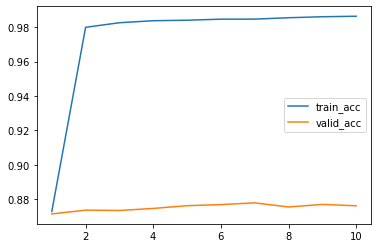

In [22]:
fig = plt.figure()
plt.plot(list(range(1, 1+epoch)), train_accs, label='train_acc')
plt.plot(list(range(1, 1+epoch)), valid_accs, label='valid_acc')
plt.legend()
plt.show()

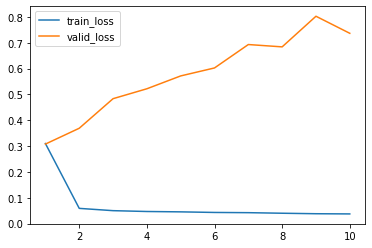

In [23]:
fig = plt.figure()
plt.plot(list(range(1, 1+epoch)), train_loss, label='train_loss')
plt.plot(list(range(1, 1+epoch)), valid_loss, label='valid_loss')
plt.legend()
plt.show()

## Test

In [24]:
def testing(batch_size, test_loader, model, device):
    model.eval()
    ret_output = []
    with torch.no_grad():
        for i, inputs in enumerate(test_loader):
            inputs = inputs.to(device, dtype=torch.long)
            outputs = model(inputs)
            outputs = outputs.squeeze()
            outputs[outputs>=0.5] = 2 
            outputs[outputs<0.5] = 1 
            ret_output += outputs.int().tolist()
    
    return ret_output

In [25]:
preprocess = Preprocess(test_x, sen_len, w2v_path=w2v_path)
embedding = preprocess.make_embedding(load=True)
test_x = preprocess.sentence_word2idx()
test_dataset = CommentDataset(X=test_x, y=None)
test_loader = torch.utils.data.DataLoader(dataset = test_dataset,
                                            batch_size = batch_size,
                                            shuffle = False,
                                            num_workers = 8)

model = torch.load(model_dir)
outputs = testing(batch_size, test_loader, model, device)

tmp = pd.DataFrame({"id":[str(i) for i in range(len(test_x))],"value":outputs})
tmp.to_csv(os.path.join(mdpt, 'self_training_predict.csv'), index=False)

Get embedding ...
loading word to vec model ...


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:35: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


total words: 102678


sentence count #3654

sentence count #7653

sentence count #10504

sentence count #11599

sentence count #19444

sentence count #25648

sentence count #29647

sentence count #33646

sentence count #37645

sentence count #41644

sentence count #45643

sentence count #49142

sentence count #53141

sentence count #56910

sentence count #67137

sentence count #77134

sentence count #93629

sentence count #97628

sentence count #99358

sentence count #100831

sentence count #102313

sentence count #109068

sentence count #112466

sentence count #118122

sentence count #121621

sentence count #125249

sentence count #129082

sentence count #132618

sentence count #136117

sentence count #139616

sentence count #143333

sentence count #147114

sentence count #150775

sentence count #158111

sentence count #162110

sentence count #166109

sentence count #169930

sentence count #173607

sentence count #181105

sentence count #187283

sentence count #188988

sentence count #190438

sentence count #196101